# **Final project - Copenahgen Aribnb**
Estel Clua i Sánchez (s232507), Víctor Sobrino Cusidó (s232773), Andrea Matamoros Alonso (s233514).

## **Motivation**
The [dataset](http://https://insideairbnb.com/get-the-data/) used for this project contains all Airbnb listings in Copenhagen up until March 2024. It contains 18545 listings and 75 columns with different attributes.

This dataset was chosen for the project development because it contained many types of information to plot different representations and make an interesting story about them. It contained geopraphical data, scoring from reviews, price per night, the seniority from the hosts and the superhost category. This last feature will be the main character from our further analysis.

The goal is to provide a meaningful insight for the user about the *superhost* category, which will be introduced in the web page. As this naming was recently introduced into the Airbnb platform, we aim to present it in an understandable way and to elucidate the real characteristics of these hosts through a thoughtful analysis, using as many features as possible to describe them.


## **Basic stats**
As a first analysis, the next characteristics were written to try to describe better the dataset. 
- Number of listints: 18545
- Most popular neighbourhood: Copenhagen Vesterbro
- Mean price: $1314.37.
- Mean number of minimum nights: 4.6.

In [1]:
# imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMap
import seaborn as sns

In [2]:
file = 'listings.csv'
data = pd.read_csv(file)

In [3]:
# Set display options to show all rows and columns
pd.set_option('display.max_rows',20)
pd.set_option('display.max_columns', None)
data


,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,772195193586734462,https://www.airbnb.com/rooms/772195193586734462,20231227173932,2024-01-03,previous scrape,Rental unit in Copenhagen · 1 bedroom · 1 bed ...,NaN,NaN,https://a0.muscache.com/pictures/miso/Hosting-...,139504671,https://www.airbnb.com/users/show/139504671,Alexandra,2017-07-09,"Copenhagen, Denmark",NaN,within an hour,100%,57%,f,https://a0.muscache.com/im/pictures/user/32ecb...,https://a0.muscache.com/im/pictures/user/32ecb...,NaN,2.0,2.0,"['email', 'phone']",t,t,NaN,Indre By,NaN,55.685219,12.565863,Private room in rental unit,Private room,2,NaN,1 shared bath,NaN,1.0,[],NaN,5,12,5,5,12,12,5.0,12.0,NaN,NaN,0,0,0,0,2024-01-03,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,2,0,2,0,NaN
1,993508926988263521,https://www.airbnb.com/rooms/993508926988263521,20231227173932,2023-12-27,city scrape,Rental unit in Copenhagen · ★4.67 · 1 bedroom ...,NaN,NaN,https://a0.muscache.com/pictures/miso/Hosting-...,540024469,https://www.airbnb.com/users/show/540024469,Marie,2023-10-02,NaN,NaN,within a few hours,100%,100%,f,https://a0.muscache.com/im/pictures/user/0c28f...,https://a0.muscache.com/im/pictures/user/0c28f...,NaN,1.0,1.0,"['email', 'phone']",t,f,NaN,Amager st,NaN,55.653641,12.613375,Entire rental unit,Entire home/apt,2,NaN,1 bath,NaN,1.0,[],$860.00,2,20,2,7,20,20,2.3,20.0,NaN,t,12,25,25,25,2023-12-27,9,9,3,2023-10-08,2023-12-22,4.67,4.67,4.67,4.78,4.78,4.67,4.67,NaN,f,1,1,0,0,3.33
2,973046361084511805,https://www.airbnb.com/rooms/973046361084511805,20231227173932,2023-12-28,city scrape,Rental unit in Copenhagen · ★4.86 · 1 bedroom ...,NaN,NaN,https://a0.muscache.com/pictures/hosting/Hosti...,413314931,https://www.airbnb.com/users/show/413314931,Julie,2021-07-16,"Copenhagen, Denmark",NaN,within a few hours,80%,57%,f,https://a0.muscache.com/im/pictures/user/57556...,https://a0.muscache.com/im/pictures/user/57556...,NaN,1.0,1.0,"['email', 'phone']",t,t,NaN,Amager Vest,NaN,55.666180,12.578590,Entire rental unit,Entire home/apt,3,NaN,1 bath,NaN,1.0,[],"$1,000.00",2,60,2,2,60,60,2.0,60.0,NaN,t,0,0,20,107,2023-12-28,7,7,3,2023-11-03,2023-12-17,4.86,4.86,4.43,4.71,4.71,5.00,4.43,NaN,f,1,1,0,0,3.75
3,52551491,https://www.airbnb.com/rooms/52551491,20231227173932,2023-12-28,city scrape,Condo in Copenhagen · ★5.0 · 1 bedroom · 1 bed...,NaN,Having won prices for its urban architecture a...,https://a0.muscache.com/pictures/ae4d3db9-9f91...,36416123,https://www.airbnb.com/users/show/36416123,Kasper,2015-06-22,"Copenhagen, Denmark",We are a friendly and outgoing Danish/Brazilia...,within a day,100%,48%,f,https://a0.muscache.com/im/pictures/user/3c864...,https://a0.muscache.com/im/pictures/user/3c864...,NaN,1.0,1.0,"['email', 'phone']",t,t

Through the next cell, we do a first tentative of a statistical analysis of the dataset but, in the end, it was decided to be centered in a set of more interesting variables for us in order to have a more feasible range for analysis.

In [4]:
data.describe()

,id,scrape_id,description,host_id,host_listings_count,host_total_listings_count,neighbourhood_group_cleansed,latitude,longitude,accommodates,bathrooms,bedrooms,beds,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
count,1.854500e+04,1.854500e+04,0.0,1.854500e+04,18544.000000,18544.000000,0.0,18545.000000,18545.000000,18545.000000,0.0,0.0,18269.000000,18545.000000,18545.000000,18545.000000,18545.000000,18545.000000,18545.000000,18545.000000,18545.000000,0.0,18545.000000,18545.000000,18545.000000,18545.000000,18545.000000,18545.000000,18545.000000,16152.000000,16151.000000,16151.000000,16151.000000,16151.000000,16148.000000,16151.000000,0.0,18545.000000,18545.000000,18545.000000,18545.000000,16144.000000
mean,4.046612e+17,2.023123e+13,NaN,1.306585e+08,5.643658,11.733175,NaN,55.680347,12.558489,3.326126,NaN,NaN,1.907986,4.555244,400.268051,4.301968,4.971529,485.528714,493.379617,4.653330,487.686789,NaN,6.895551,15.552925,24.510057,85.512321,17.903208,5.330493,0.251011,4.818393,4.839057,4.694532,4.872860,4.910766,4.834828,4.711502,NaN,3.598544,3.397196,0.194823,0.004907,0.733334
std,4.220116e+17,1.179719e+00,NaN,1.560731e+08,35.369401,81.607273,NaN,0.019162,0.031342,1.650973,NaN,NaN,1.262171,18.812196,451.383226,17.511643,18.624052,482.953391,483.915412,18.048801,482.140512,NaN,10.517111,22.109769,33.976144,120.686934,40.394133,12.243022,0.909830,0.285395,0.270839,0.391467,0.257222,0.220142,0.240718,0.323803,NaN,19.060369,19.069972,0.882589,0.106049,1.001708
min,2.605700e+04,2.023123e+13,NaN,5.130000e+02,1.000000,1.000000,NaN,55.615890,12.454000,1.000000,NaN,NaN,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,NaN,1.000000,0.000000,0.000000,0.000000,0.010000
25%,2.639056e+07,2.023123e+13,NaN,1.634132e+07,1.000000,1.000000,NaN,55.666249,12.540837,2.000000,NaN,NaN,1.000000,2.000000,20.000000,2.000000,2.000000,21.000000,22.000000,2.000000,22.000000,NaN,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,4.750000,4.780000,4.560000,4.830000,4.900000,4.750000,4.600000,NaN,1.000000,1.000000,0.000000,0.000000,0.210000
50%,5.393807e+07,2.023123e+13,NaN,5.799822e+07,1.000000,1.000000,NaN,55.681420,12.555170,3.000000,NaN,NaN,1.000000,3.000000,365.000000,3.000000,3.000000,365.000000,365.000000,3.000000,365.000000,NaN,0.000000,0.000000,1.000000,13.000000,7.000000,2.000000,0.000000,4.900000,4.920000,4.800000,4.960000,5.000000,4.910000,4.770000,NaN,1.000000,1.000000,0.000000,0.000000,0.430000
75%,8.492742e+17,2.023123e+13,NaN,1.876103e+08,1.000000,2.000000,NaN,55.695610,12.580360,4.000000,NaN,NaN,2.000000,4.000000,1125.000000,4.000000,4.000000,1125.000000,1125.000000,4.000000,1125.000000,NaN,13.000000,30.000000,54.000000,145.000000,18.000000,6.000000,0.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,4.940000,NaN,1.000000,1.000000,0.000000,0.000000,0.880000
max,1.054958e+18,2.023123e+13,NaN,5.525667e+08,814.000000,1836.000000,NaN,55.732470,12.639720,16.000000,NaN,NaN,14.000000,1122.000000,4000.000000,1122.000000,1122.000000,4000.000000,4000.000000,1122.000000,4000.000000,NaN,30.000000,60.000000,90.000000,365.000000,1531.000000,767.000000,37.000000,5.000000,5.000000,5.080000,5.000000,5.000000,5.000000,5.000000,NaN,186.000000,186.000000,17.000000,3.000000,37.86

Something that could be appreciated from the cell above is the large quantity of empty values in some of the features. For that reason, we perform the next analysis, aiming to clean our dataset from attributes that do not bring valuable information for us and ease further data exploration.

In [5]:
# Number of NaN values per columns
nan_counts = data.isna().sum()
print('Total number of rows:', data.shape[0], '\n')
for column, count in nan_counts.items():
    #print(f"Column '{column}' has {count} NaN values.")
    print(f"{count} NaN values in column '{column}'.")

Total number of rows: 18545 

0 NaN values in column 'id'.
0 NaN values in column 'listing_url'.
0 NaN values in column 'scrape_id'.
0 NaN values in column 'last_scraped'.
0 NaN values in column 'source'.
0 NaN values in column 'name'.
18545 NaN values in column 'description'.
9985 NaN values in column 'neighborhood_overview'.
0 NaN values in column 'picture_url'.
0 NaN values in column 'host_id'.
0 NaN values in column 'host_url'.
1 NaN values in column 'host_name'.
1 NaN values in column 'host_since'.
2824 NaN values in column 'host_location'.
10396 NaN values in column 'host_about'.
8328 NaN values in column 'host_response_time'.
8328 NaN values in column 'host_response_rate'.
3159 NaN values in column 'host_acceptance_rate'.
32 NaN values in column 'host_is_superhost'.
1 NaN values in column 'host_thumbnail_url'.
1 NaN values in column 'host_picture_url'.
12956 NaN values in column 'host_neighbourhood'.
1 NaN values in column 'host_listings_count'.
1 NaN values in column 'host_tota

As we can see, there are many features containing a lot of empty values. Other do not contain as much, but we chose to remove them from the data because they were not interesting for our intended purpose.

In [6]:
data = data.drop(columns=['license', 'host_about', 'calendar_updated', 'bedrooms', 'bathrooms', 'description', 'neighbourhood', 'neighbourhood_group_cleansed', 'neighborhood_overview', 'picture_url', 'host_url', 'listing_url'])

We can see that in total we dropped 12 columns that were considered uninteresting for us. In the cell below, it can be appreciated how we treat the pricing data, since it had an unadequate format. First of all, we remove any undesirable characters and then we turn it into a float. After it, we try to get some statistics about pricing, like the mean and, further down, the median.

In [7]:
# Calculate mean of prices
# turn price column into a float
data['price'] = data['price'].str.replace('$', '')
data['price'] = data['price'].str.replace(',', '')
data['price'] = data['price'].astype(float)
mean_price = data['price'].mean()
std_price = data['price'].std()
print(f"The mean price is {mean_price} ± {std_price}.")
median_price = data['price'].median()
print(f"The median of the prices is {median_price}.")

The mean price is 1314.3667595933093 ± 1520.8288142610077.
The median of the prices is 1100.0.


From the data above, we can really see that the price has a great variety among different listings, but the median indicates us that these range, despite of being big, does not contain extremely large prices in reality. Therefore, we might be inclined to think that the very high and low prices might be outliers among the listings.

In [8]:
# Group latitude and longitude values together and count occurrences
grouped_data = data.groupby(['latitude', 'longitude']).size().reset_index(name='count')

# Create a base map with a predefined zoom level (e.g., zoom level 5)
m = folium.Map(location=[55.690732, 12.559864], zoom_start=12)

# Add heatmap layer with a smaller radius for more defined zones
heat_data = [[row['latitude'], row['longitude'], row['count']] for index, row in grouped_data.iterrows()]
HeatMap(heat_data, radius=10).add_to(m)

# Display the map
m

Vesterbro, together with Norrebro, are the areas in the city which have more density of avilable Airbnb hostings, both with more than 3000 listings at the moment. Below, we fill empty prices by the median, since it us an unbiased measure that will not introduce error in our further analysis.

In [9]:
# Substitute NaNs with the median
data['price'] = data['price'].fillna(median_price)

In [10]:
# Group latitude, longitude, and price together and aggregate prices
grouped_data = data.groupby(['latitude', 'longitude'])['price'].mean().reset_index()

# Create a base map with a predefined zoom level
m = folium.Map(location=[data['latitude'].mean(), data['longitude'].mean()], zoom_start=12)

# Convert DataFrame to list of lists for HeatMap
heat_data = [[row['latitude'], row['longitude'], row['price']] for index, row in grouped_data.iterrows()]

# Add heatmap layer
HeatMap(heat_data, radius=10).add_to(m) 

# Display the map
m

The median price is 1100.0.


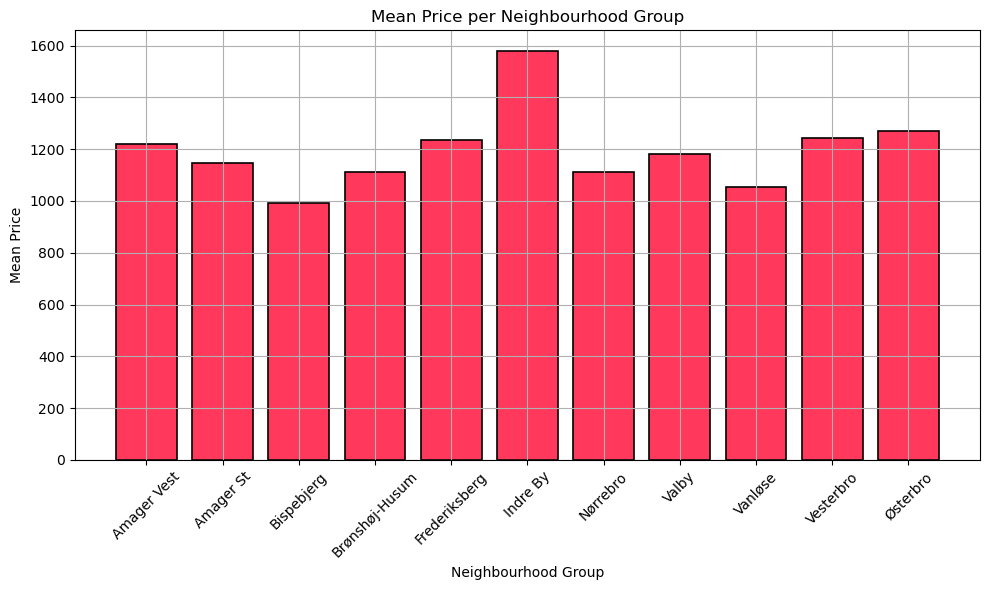

In [11]:
# Get median of the prices
median_price = data['price'].median()
print(f"The median price is {median_price}.")

# Substitute NaNs with the median
data['price'] = data['price'].fillna(median_price)

# Group data by neighbourhood and calculate the mean price
grouped_data = data.groupby('neighbourhood_cleansed')['price'].mean().reset_index()

x_labels = ["Amager Vest", "Amager St", "Bispebjerg", "Brønshøj-Husum", "Frederiksberg", "Indre By", "Nørrebro", "Valby", "Vanløse", "Vesterbro", "Østerbro"]
# Plot the mean price per neighbourhood
plt.figure(figsize=(10, 6))
plt.bar(x_labels, grouped_data['price'], color='#ff385c', edgecolor='black', linewidth=1.2)
plt.xlabel('Neighbourhood Group')
plt.ylabel('Mean Price')

plt.title('Mean Price per Neighbourhood Group')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.savefig("prices_neigh.pdf")
plt.show()


The most expensive neighbourhood is Indre By, which corresponds to Copenhagen city center, inside of Copenhagen metropolitan area. This price difference is obvious, since it is much more convenient for toursits to be hosted right in the city center, to be as close as possible to all the touristy attractions and to avoid using public transport, which can become one of the main expenses when travelling around Copenhagen. Despite of this, some other neighbourhoods, such as Frederiksberg and Norrebro, could also be good choices for your stay in the city.

Norrebro is a bustling part of Copenhagen, a multicultural neighbourhood full of places with quite the charm and very interesting cafés, whose popularity has grown over the years among university students and alternative crowds. On the other hand, Frederiskberg is a much more quiet part of the city, due to its residential nature. Here, you can find some interesting place,s such as the Zoo, Frederiskberg Palace and Gardens and even an underground museum, Cisternerne. 

In [12]:
# create a map by host scores
grouped_data = data.groupby(['latitude', 'longitude'])['review_scores_rating'].mean().reset_index()

# remove hosts that do not have ratings
grouped_data = grouped_data.dropna()

# Create a base map with a predefined zoom level
m = folium.Map(location=[data['latitude'].mean(), data['longitude'].mean()], zoom_start=12)

# Convert DataFrame to list of lists for HeatMap
heat_data = [[row['latitude'], row['longitude'], row['review_scores_rating']] for index, row in grouped_data.iterrows()]

# Add heatmap layer
HeatMap(heat_data, radius=10).add_to(m)

# Display the map
m

The map represented above do not provide very valueable information in the for of heatmaps. Due to this, further on in our analysis, we explore different ways of creating map representation for visually aiding the user into understanding the data distribution.

In [13]:
#host_response_time
superhosts_counts = data['host_is_superhost'].value_counts()
print(superhosts_counts)

host_response_time_counts = data['host_response_time'].value_counts()
print(host_response_time_counts)

host_is_superhost
f    16188
t     2325
Name: count, dtype: int64
host_response_time
within an hour        4399
within a day          2901
within a few hours    2180
a few days or more     737
Name: count, dtype: int64


As mentioned above, our analysis will be centered in the *Superhost* figure, to bring light into this new designated category and inform Airbnb users of the benefits or the harms of being hosted by a *Superhost*.

From this Exploratory Data analysis (EDA), we have inferred that general data about Airbnb listings around the city could have some potential, but that really a more interesting analysis could be provided from an analysis of the *Superhost* figure. Therefore, this EDA has been used as an introduction for one our posts, but the further analysis was carried out in order to brin more interesting and useful facts about these hosts to the user. Therefore, we move to our data analysis section.

## **Data analysis**
**SUPER HOSTS**

**What are super hosts?** *Airbnb Superhost* is a program designed by Airbnb to identify, promote and reward the most hospitable hosts in the website. They are hosts with more experience who are well rated by travelers and that can be set as en example for the whole Airbnb community. These hosts stand out for being able to offer memorable experiences to travelers staying with them.

**What are the criteria for an average host to be able to become a superhost?** Airbnb monitors hosts activities 4 times a year (every trimester) and performs evaluations on profiles. These are some prerequisites that might grant a superhost stamp for a host profile:
- Succesfully conclude at least 10 booked trips or 3 trips with a total stay of, at least, 100 nights.
- Keep a comment rate for the trips of, at least, 50% from all the bookings.
- Keep a guest response rate of, at least, 90% from all contacts done for your lodgings.
- Having 0 cancellations (exceptuating the ones included in Major Disruptive Events Policy).
- Keepoing an overall score of 4,8.

From these information, it can be considered that superhosts might really be able to offer an outstanding experience at their lodgings and, with this post, we aim to study this specific category of host to confirm or deny such statement. In the dataset at hand, we counted on 2325 profiles of superhost for the evaluation, against 16188 regular hosts.

From this data analysis we have learnt many different characteristics from the *Supehosts* and we have aknowledged that their privilege has been granted for a fairly good reason. During the analysis, we will consider the results from the different visualizations and plots. 

host_is_superhost
f    16188
t     2325
Name: count, dtype: int64
host_response_time
within an hour        4399
within a day          2901
within a few hours    2180
a few days or more     737
Name: count, dtype: int64
host_is_superhost  host_response_time
f                  a few days or more     730
                   within a day          2596
                   within a few hours    1757
                   within an hour        3318
t                  a few days or more       7
                   within a day           302
                   within a few hours     420
                   within an hour        1065
dtype: int64


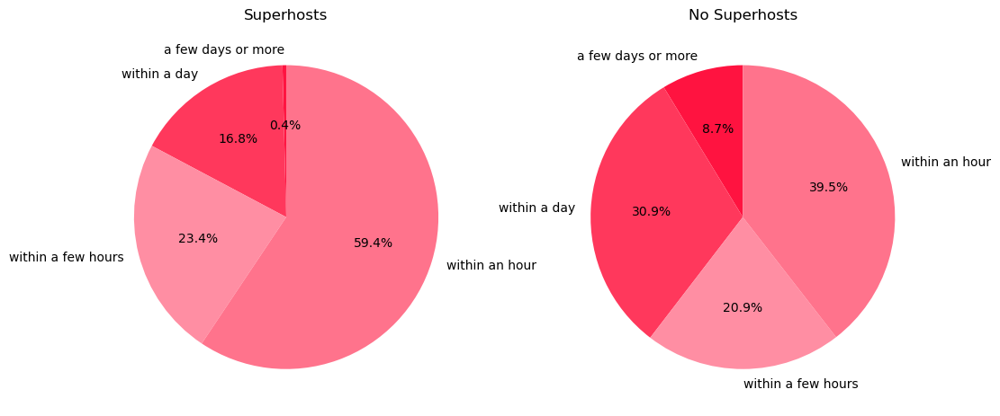

In [14]:
#host_response_time
superhosts_counts = data['host_is_superhost'].value_counts()
print(superhosts_counts)

host_response_time_counts = data['host_response_time'].value_counts()
print(host_response_time_counts)

host_response_rate_counts = data['host_response_rate'].value_counts()
#print(host_response_rate_counts)

response_counts = data.groupby(['host_is_superhost', 'host_response_time']).size()

print(response_counts)
colors = ["#ff1340", "#ff385c", "#ff8ea3", "#ff738c", "#ffbbc7", "#ffd5dd"]

# Filtrar los conteos para superhosts y no superhosts
superhost_counts = response_counts['t']
non_superhost_counts = response_counts['f']

# Crear los gráficos circulares
fig, axs = plt.subplots(1, 2, figsize=(12, 6))

# Gráfico para superhosts
axs[0].pie(superhost_counts, labels=superhost_counts.index, autopct='%1.1f%%', startangle=90, colors = colors)
axs[0].set_title('Superhosts')

# Gráfico para no superhosts
axs[1].pie(non_superhost_counts, labels=non_superhost_counts.index, autopct='%1.1f%%', startangle=90, colors = colors)
axs[1].set_title('No Superhosts')
plt.savefig("responses.pdf")
plt.show()

**Commentary on Pie Charts Evaluating Host Response Time**

The pie charts above provide a visual representation of the host response time for both Superhosts and non-Superhosts within the context of Airbnb listings. Host response time is a critical factor influencing the overall guest experience and satisfaction, making it imperative to examine its distribution across different categories.

For non-Superhosts, the majority of responses fall within the categories of "within an hour" and "within a day," comprising 39.5% and 30.9% of the total responses, respectively. This suggests that a significant proportion of non-Superhosts prioritize prompt communication with guests, with a considerable effort to address inquiries and requests in a timely manner. However, it's noteworthy that a non-negligible portion of responses, 20.9%, takes "within a few hours, and 8.7% takes "á few days or more" indicating a slightly longer turnaround time for some hosts.

In contrast, Superhosts demonstrate even higher responsiveness, with an 59.4% of responses falling within the "within an hour" category. This underscores the dedication of Superhosts to ensuring swift and efficient communication with guests, thereby enhancing the overall guest experience and satisfaction. Furthermore, the distribution of responses among Superhosts reflects a streamlined approach, with minimal instances of responses taking "a few days or more."

Overall, the pie charts provide valuable insights into the host response time dynamics within the Airbnb ecosystem, highlighting the distinctive approach adopted by Superhosts in prioritizing prompt and effective communication with guests. These findings underscore the importance of responsiveness in fostering positive guest experiences and contribute to the broader discourse on hospitality excellence within the sharing economy.

In [15]:
#response rate
response_counts = data.groupby(['host_is_superhost', 'host_response_rate']).size().reset_index(name='count')


df_f = response_counts[response_counts['host_is_superhost'] == 'f']
df_t = response_counts[response_counts['host_is_superhost'] == 't']


In [16]:
def categorize_percentage(percentage):
    if percentage == '100%':
        return '100%'
    elif '50%' in percentage or '99%' in percentage:
        return 'between 50% and 99%'
    else:
        return 'less than 50%'

# Aplicar la función a la columna 'host_response_rate' y crear una nueva columna 'response_group'
df_f['response_group'] = df_f['host_response_rate'].apply(categorize_percentage)

# Agrupar y sumar los recuentos por grupo de respuesta
grouped_data_f = df_f.groupby('response_group')['count'].sum().reset_index()

print(grouped_data_f)

df_t['response_group'] = df_t['host_response_rate'].apply(categorize_percentage)

# Agrupar y sumar los recuentos por grupo de respuesta
grouped_data_t = df_t.groupby('response_group')['count'].sum().reset_index()

print(grouped_data_t)

        response_group  count
0                 100%   6375
1  between 50% and 99%    246
2        less than 50%   1780
        response_group  count
0                 100%   1680
1  between 50% and 99%      7
2        less than 50%    107


C:\Users\victo\AppData\Local\Temp\ipykernel_43792\2198642684.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_f['response_group'] = df_f['host_response_rate'].apply(categorize_percentage)
C:\Users\victo\AppData\Local\Temp\ipykernel_43792\2198642684.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_t['response_group'] = df_t['host_response_rate'].apply(categorize_percentage)


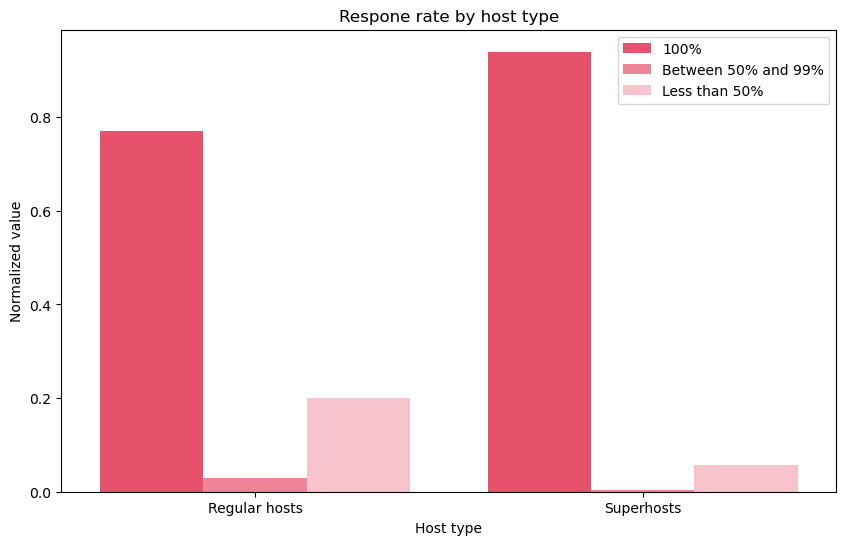

In [17]:
# Crea un DataFrame de ejemplo con los datos proporcionados
data = {
    'host_is_superhost': ['Regular hosts', 'Regular hosts', 'Regular hosts', 'Superhosts', 'Superhosts', 'Superhosts'],
    'response_time': ['100%', 'between 50% and 99%', 'less than 50%',
                      '100%', 'between 50% and 99%', 'less than 50%'],
    'count': [0.770921, 0.029731, 0.199348, 0.939655, 0.003879, 0.056466]
}

df = pd.DataFrame(data)

colors = ["#ff385c", "#ff738c", "#ffbbc7"]

# Mapear las categorías de respuesta de tiempo a etiquetas legibles
response_mapping = {
    '100%': '100%',
    'between 50% and 99%': 'Between 50% and 99%',
    'less than 50%': 'Less than 50%'
}
df['response_time'] = df['response_time'].map(response_mapping)

# Crear el gráfico de barras con categorías anidadas
plt.figure(figsize=(10, 6))
sns.barplot(x='host_is_superhost', y='count', hue='response_time', data=df, palette=colors)
plt.title('Respone rate by host type')
plt.xlabel('Host type')
plt.ylabel('Normalized value')
plt.legend()
plt.savefig("response_time.pdf")
plt.show()

**Commentary on Bar Charts Evaluating Host Response Rate**

The bar charts presented above offer a comprehensive visualization of host response rates, categorized into three distinct groups: '100%', 'between 50% and 99%', and 'less than 50%'. These metrics serve as critical indicators of host engagement and commitment to addressing guest inquiries and requests promptly, thereby significantly influencing the overall guest experience.

For non-Superhosts, the distribution of response rates reveals a predominant emphasis on maintaining high levels of responsiveness, with a substantial proportion of hosts demonstrating a "100%" response rate. This underscores a commendable commitment among non-superhosts to ensure timely communication with guests, thereby fostering positive guest experiences. However, a small percentage of hosts fall into the "between 50% and 99%" category, indicating a moderate level of responsiveness, while an even larger percentage fall into the "less than 50%" category, suggesting that this subset of hosts can improve their responsiveness.
In contrast, Superhosts show an exemplary level of responsiveness, with an overwhelming majority boasting a "100%" response rate. This signifies a remarkable dedication on the part of Super Hosts to promptly address guests' queries and requests, exemplifying excellence in hospitality within the Airbnb ecosystem. Furthermore, the negligible presence of Super Hosts within the "less than 50%" category underscores this cohort's unwavering commitment to ensuring optimal guest satisfaction through timely communication and engagement.

In summary, the bar charts provide an overview of host response rates, highlighting the stark contrast between non-Superhosts and Superhosts in terms of responsiveness. It's worth noting that while there is a difference between the two groups, it may not be very significant.

**REVIEWS**

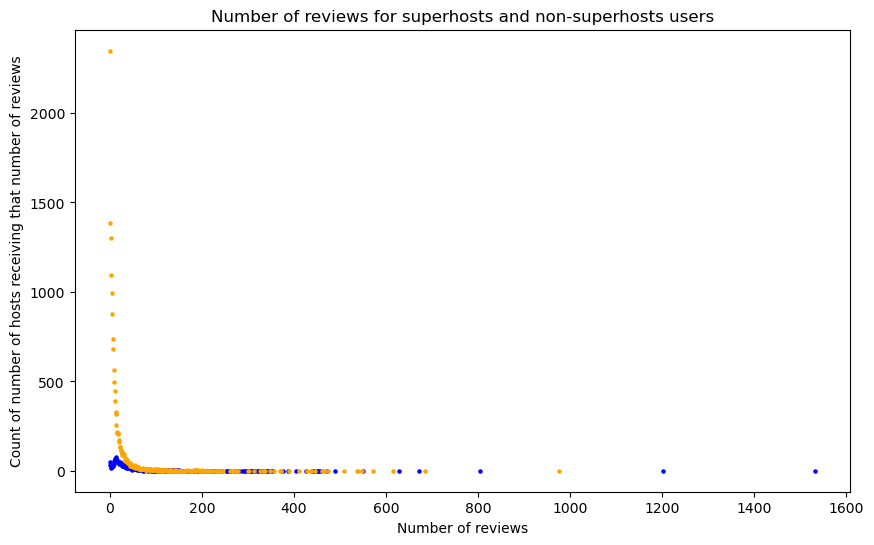

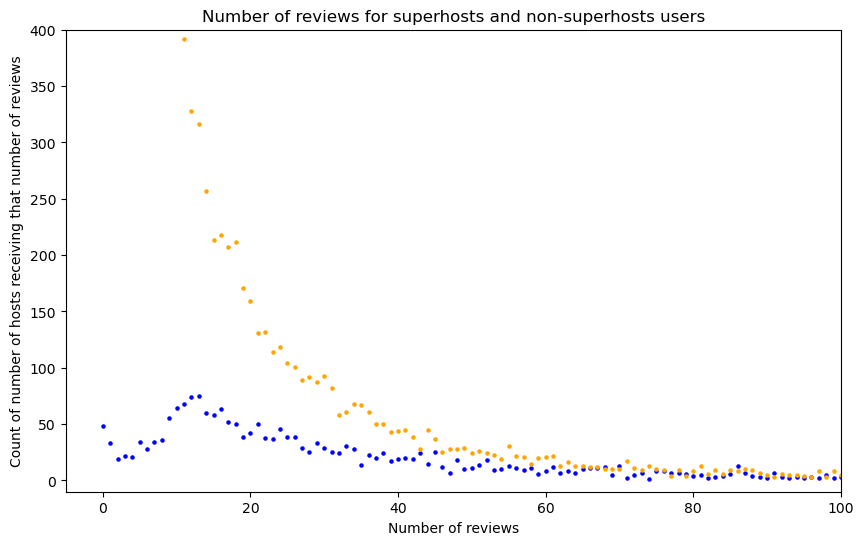

In [27]:
#reviews: aqui number of reviews. first review, last review, fe rlinea del temps amb scatter plot
file = 'listings.csv'
df = pd.read_csv(file)

response_counts = df.groupby(['host_is_superhost', 'number_of_reviews']).size().reset_index(name='count')
response_counts

df_f = response_counts[response_counts['host_is_superhost'] == 'f']
df_t = response_counts[response_counts['host_is_superhost'] == 't']

df_t_nums = df_t['number_of_reviews'].tolist()
df_t_counts = df_t['count'].tolist()

df_f_nums = df_f['number_of_reviews'].tolist()
df_f_counts = df_f['count'].tolist()

df_t_nums

plt.figure(figsize=(10, 6))
plt.scatter(df_t_nums,df_t_counts, c='blue',s=5)
plt.scatter(df_f_nums,df_f_counts, c='orange',s=5)
plt.title('Number of reviews for superhosts and non-superhosts users')
plt.ylabel('Count of number of hosts receiving that number of reviews')
#plt.xlim(-30,100)
plt.xlabel('Number of reviews')
#plt.ylim(0,400)
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(df_t_nums,df_t_counts, c='blue',s=5)
plt.scatter(df_f_nums,df_f_counts, c='orange',s=5)
plt.title('Number of reviews for superhosts and non-superhosts users')
plt.ylabel('Count of number of hosts receiving that number of reviews')
plt.xlim(-5,100)
plt.xlabel('Number of reviews')
plt.ylim(-10,400)
plt.show()


From this plot, which has its interactive version below, we can appreciate that Superhosts have less empty reviews than regular hosts, but no other valueable information can be extracted from this. This roots from the nature of the superhosts designation itself, in which it is included a condition for which a certain percentage hosted clients has to leave a review for them to belong to that category.

In [28]:
from bokeh.plotting import figure, show, save, output_notebook

output_notebook()

response_counts = df.groupby(['host_is_superhost', 'number_of_reviews']).size().reset_index(name='count')
response_counts

df_f = response_counts[response_counts['host_is_superhost'] == 'f']
df_t = response_counts[response_counts['host_is_superhost'] == 't']

df_t_nums = df_t['number_of_reviews'].tolist()
df_t_counts = df_t['count'].tolist()

df_f_nums = df_f['number_of_reviews'].tolist()
df_f_counts = df_f['count'].tolist()

df_t_nums

# Assuming df_t_nums, df_t_counts, df_f_nums, df_f_counts are your data
# Replace them with your actual data

# Create a Bokeh figure
p = figure(width=400, height=400, x_axis_label='Number of reviews', y_axis_label='Host count per number of reviews', title='Number of reviews for superhosts and non-superhosts users')

# Add circle renderers with a size, color, and alpha for superhosts and regular hosts
p.circle(df_t_nums, df_t_counts, size=20, color="navy", alpha=0.5, legend_label="Superhosts")
p.circle(df_f_nums, df_f_counts, size=20, color="orange", alpha=0.5, legend_label="Regular hosts")

# Set legend location
p.legend.location = "top_right"

# Show the plot
show(p)


save(p, "nummber_host_reviews-html")

Loading BokehJS ...

C:\Users\victo\AppData\Local\Temp\ipykernel_43792\360183620.py:36: UserWarning: save() called but no resources were supplied and output_file(...) was never called, defaulting to resources.CDN
  save(p, "nummber_host_reviews-html")
C:\Users\victo\AppData\Local\Temp\ipykernel_43792\360183620.py:36: UserWarning: save() called but no title was supplied and output_file(...) was never called, using default title 'Bokeh Plot'
  save(p, "nummber_host_reviews-html")


'C:\\Users\\victo\\OneDrive\\Escritorio\\UNI\\DTU\\q2\\Social Data\\project\\nummber_host_reviews-html'

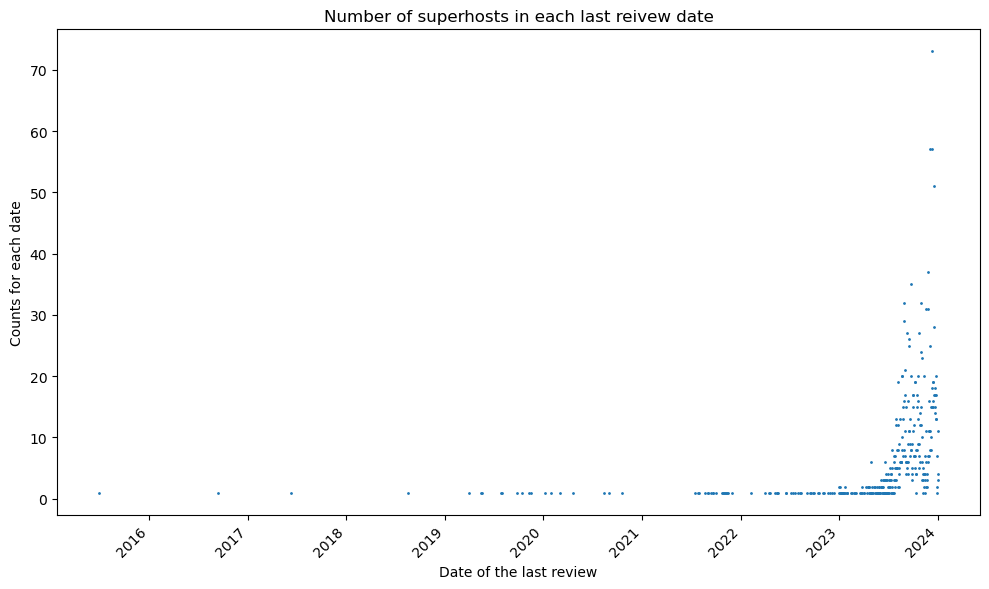

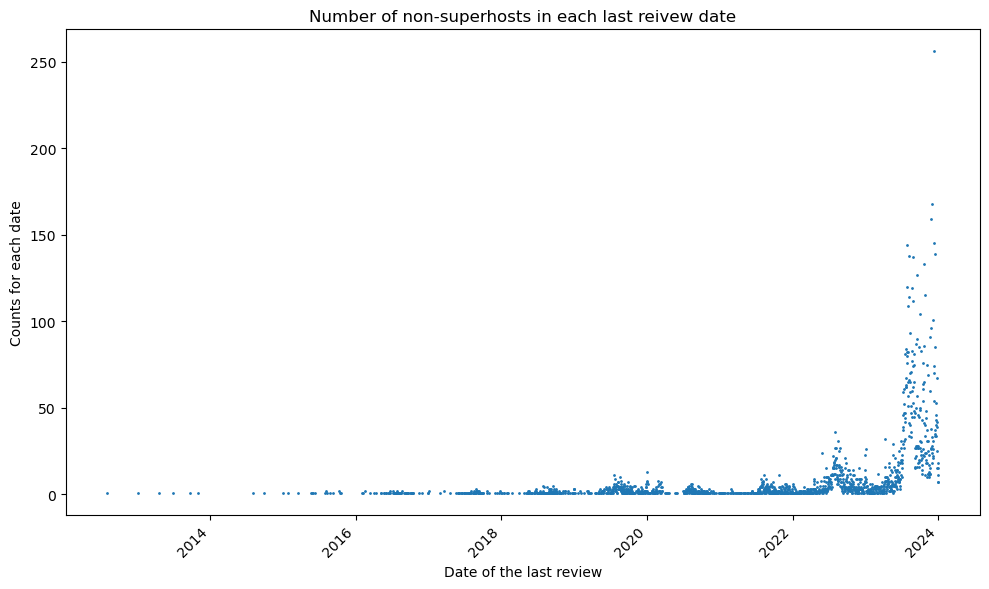

In [29]:
response_counts1 = df.groupby(['host_is_superhost', 'last_review']).size().reset_index(name='count')

df_f1 = response_counts1[response_counts1['host_is_superhost'] == 'f']
df_t1 = response_counts1[response_counts1['host_is_superhost'] == 't']


df_t1_nums = df_t1['last_review'].tolist()
df_t1_counts = df_t1['count'].tolist()

df_f1_nums = df_f1['last_review'].tolist()
df_f1_counts = df_f1['count'].tolist()


data = {
    'first_review':df_t1_nums,
    'count': df_t1_counts
}
df = pd.DataFrame(data)
df['first_review'] = pd.to_datetime(df['first_review'])
df = df.sort_values(by='first_review')
plt.figure(figsize=(10, 6))
plt.scatter(df['first_review'], df['count'], marker='o', s=1)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Date of the last review')
plt.ylabel('Counts for each date')
plt.title('Number of superhosts in each last reivew date')
plt.tight_layout()
plt.show()

data = {
    'first_review':df_f1_nums,
    'count': df_f1_counts
}
df = pd.DataFrame(data)
df['first_review'] = pd.to_datetime(df['first_review'])
df = df.sort_values(by='first_review')
plt.figure(figsize=(10, 6))
plt.scatter(df['first_review'], df['count'], marker='o',s=1)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Date of the last review')
plt.ylabel('Counts for each date')
plt.title('Number of non-superhosts in each last reivew date')
plt.tight_layout()
plt.show()

#hacer texto de que vemos mas recent activity en superhostst


These visualizations above do not really tell us much, since we already know that the *superhost* category is quite recent, so their absence at some points and less density was already guessed by us. This plot served to confirm our suspictions.

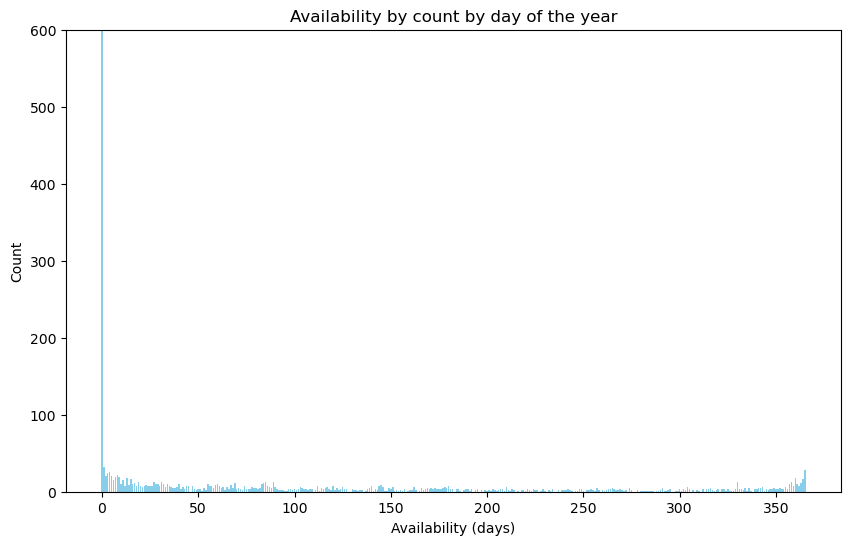

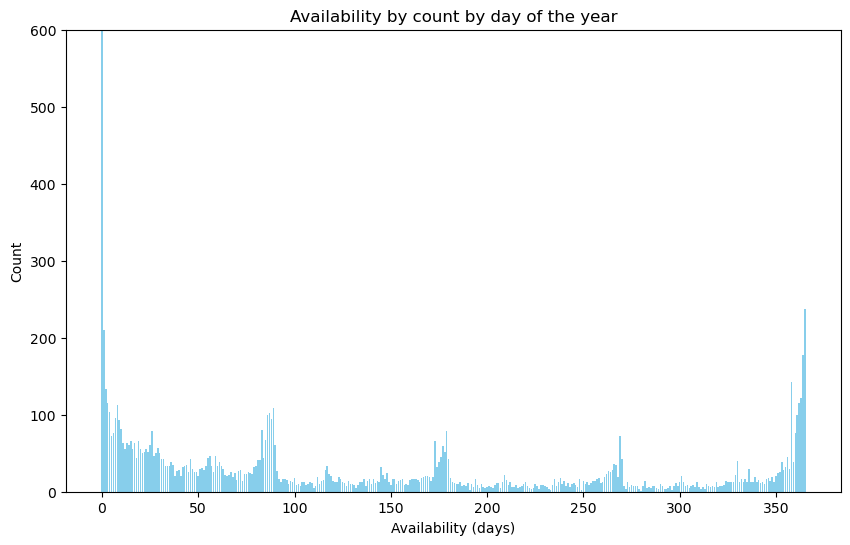

In [31]:
#availability: no creo que sea muy onteresante nada de availability, sale batsante proporiconal (pensar que hay muchos mas de no superhots, si se normaliza slae parecido)
pd.set_option('display.max_rows',30)
pd.set_option('display.max_columns', None)
file = 'listings.csv'
df = pd.read_csv(file)

availability_30 = df.groupby(['host_is_superhost', 'availability_30']).size().reset_index(name='count')
availability_60 = df.groupby(['host_is_superhost', 'availability_60']).size().reset_index(name='count')
availability_90 = df.groupby(['host_is_superhost', 'availability_90']).size().reset_index(name='count')
availability_365 = df.groupby(['host_is_superhost', 'availability_365']).size().reset_index(name='count')

availability_30_f = availability_30[availability_30['host_is_superhost'] == 'f']
availability_30_t = availability_30[availability_30['host_is_superhost'] == 't']

availability_60_f = availability_60[availability_60['host_is_superhost'] == 'f']
availability_60_t = availability_60[availability_60['host_is_superhost'] == 't']

availability_90_f = availability_90[availability_90['host_is_superhost'] == 'f']
availability_90_t = availability_90[availability_90['host_is_superhost'] == 't']

availability_365_f = availability_365[availability_365['host_is_superhost'] == 'f']
availability_365_t = availability_365[availability_365['host_is_superhost'] == 't']

availability_365_t

plt.figure(figsize=(10, 6))
plt.bar(availability_365_t['availability_365'], availability_365_t['count'], color='skyblue')
plt.xlabel('Availability (days)')
plt.ylabel('Count')
plt.title('Availability by count by day of the year')
plt.ylim(0,600)
plt.show()

plt.figure(figsize=(10, 6))
plt.bar(availability_365_f['availability_365'], availability_365_f['count'], color='skyblue')
plt.xlabel('Availability (days)')
plt.ylabel('Count')
plt.title('Availability by count by day of the year')
plt.ylim(0,600)
plt.show()

Here, we can see the availability of hosts and *superhosts* does not really differ along the year, since the distributions look pretty similar, with the peaks grouped around important dates, like CHristmas and Easter holidays.

   host_is_superhost        host_verifications  count
0                  f  Email, Phone, Work_email   1337
1                  f              Email, Phone  13206
2                  f                     Email      9
3                  f         Phone, Work_email     49
4                  f                     Phone   1578
5                  t  Email, Phone, Work_email    276
6                  t              Email, Phone   1903
7                  t                     Email      1
8                  t         Phone, Work_email      6
9                  t                     Phone    139
10                 f                      None      8
   host_is_superhost        host_verifications  count
0                  f  Email, Phone, Work_email   1337
1                  f              Email, Phone  13206
2                  f                     Email      9
3                  f         Phone, Work_email     49
4                  f                     Phone   1578
10                 f        

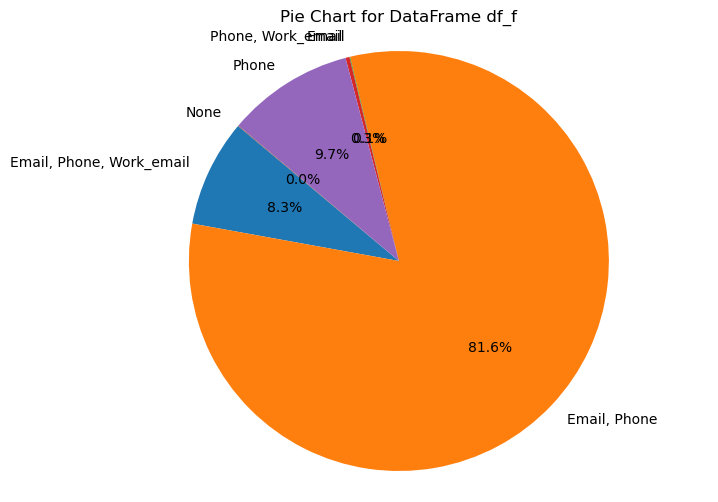

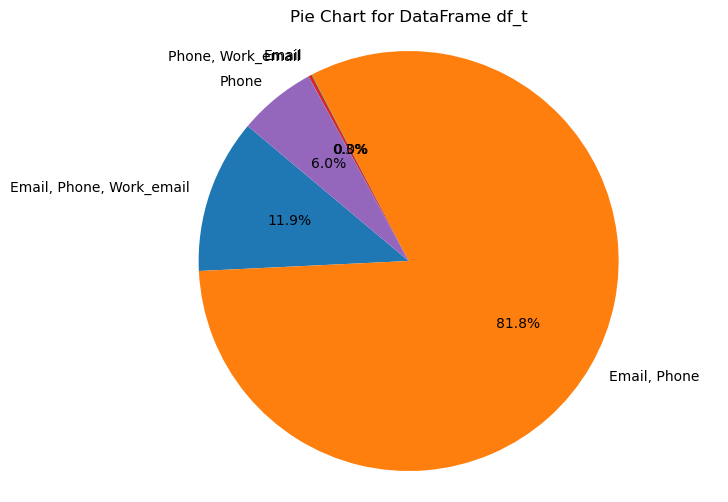

In [35]:
pd.set_option('display.max_rows',None)
pd.set_option('display.max_columns', None)
file = 'listings.csv'
df = pd.read_csv(file)

verification_counts = df.groupby(['host_is_superhost', 'host_verifications']).size().reset_index(name='count')

verification_counts = verification_counts[verification_counts['host_verifications'] != '[]']
verification_counts = verification_counts[verification_counts['host_verifications'] != "['email', 'phone', 'photographer']"]

nueva_fila = {'host_is_superhost': 'f', 'host_verifications': 'None', 'count': 8}

nuevo_df = pd.DataFrame([nueva_fila])

verification_counts = pd.concat([verification_counts, nuevo_df], ignore_index=True)

df_f = verification_counts[verification_counts['host_is_superhost'] == 'f']
df_t = verification_counts[verification_counts['host_is_superhost'] == 't']

verification_counts

df = pd.DataFrame(verification_counts)
def procesar_valor(valor):
    if valor is None:
        return None
    else:
        valor = valor.strip("[]").replace("'", "").split(', ')
        valor = [v.capitalize() for v in valor]
        return valor

df['host_verifications'] = df['host_verifications'].apply(procesar_valor)

df['host_verifications'] = df['host_verifications'].apply(lambda x: ', '.join(x) if x is not None else None)

print(df)
df_f = df[df['host_is_superhost'] == 'f']
df_t = df[df['host_is_superhost'] == 't']
print(df_f)
print(df_t)

def create_pie_chart(df, title):
    plt.figure(figsize=(8, 6))
    plt.pie(df['count'], labels=df['host_verifications'], autopct='%1.1f%%', startangle=140)
    plt.title(title)
    plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
    plt.show()

# Create pie chart for df_f
create_pie_chart(df_f, "Pie Chart for DataFrame df_f")

# Create pie chart for df_t
create_pie_chart(df_t, "Pie Chart for DataFrame df_t")

In the polar plots above we can see the fractions of the hosts who have been verified in different ways: email, phone, work email... In general, they are not so different, so we wouldn't see this is a characteristic that makes *Supehosts* stand out compared to regular hosts.

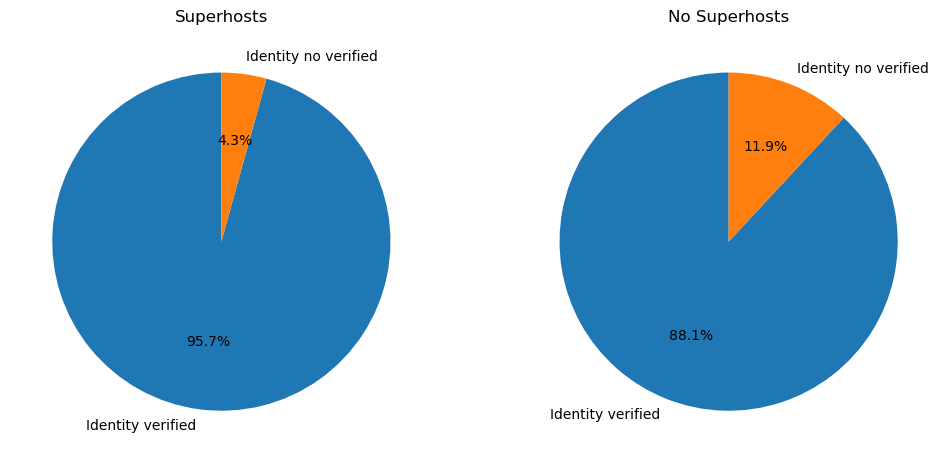

In [36]:
#host_identity_verified
pd.set_option('display.max_rows',30)
pd.set_option('display.max_columns', None)
file = 'listings.csv'
df = pd.read_csv(file)
response_counts1 = df.groupby(['host_is_superhost', 'host_identity_verified']).size().reset_index(name='count')
response_counts1.head()

df_f1 = response_counts1[response_counts1['host_is_superhost'] == 'f']
df_t1 = response_counts1[response_counts1['host_is_superhost'] == 't']

df_f1

labels = 'Identity verified', 'Identity no verified'
nosuper = [14259, 1928]
sisuper = [2225, 100]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))

# Gráfico para superhosts
axs[0].pie(sisuper, labels=labels, autopct='%1.1f%%', startangle=90)
axs[0].set_title('Superhosts')

# Gráfico para no superhosts
axs[1].pie(nosuper, labels=labels, autopct='%1.1f%%', startangle=90)
axs[1].set_title('No Superhosts')

plt.show()

Despite of this, for this way of interpreting tha data, we can see that a bigger number of *Superhosts* have their identity verified on the platform, which is not realted to being a *Superhost*, but that can definitely help them in getting more reservations on a first instance.

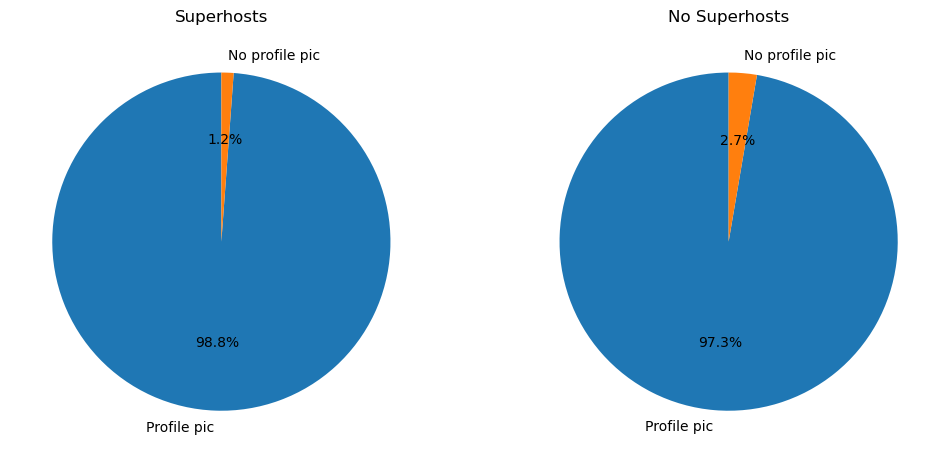

In [37]:
#host_has_profile_pic

response_counts1 = df.groupby(['host_is_superhost', 'host_has_profile_pic']).size().reset_index(name='count')

df_f1 = response_counts1[response_counts1['host_is_superhost'] == 'f']
df_t1 = response_counts1[response_counts1['host_is_superhost'] == 't']

df_f1


labels = 'Profile pic', 'No profile pic'
nosuper = [15753, 434]
sisuper = [2298, 27]

fig, axs = plt.subplots(1, 2, figsize=(12, 6))

# Gráfico para superhosts
axs[0].pie(sisuper, labels=labels, autopct='%1.1f%%', startangle=90)
axs[0].set_title('Superhosts')

# Gráfico para no superhosts
axs[1].pie(nosuper, labels=labels, autopct='%1.1f%%', startangle=90)
axs[1].set_title('No Superhosts')

plt.show()

In [38]:
#review_scores_cleanliness, review_scores_checkin, review_scores_communication, review_scores_location !!!!!!!!!!!!!!falta hacer el jitter plot

file = 'listings.csv'
df = pd.read_csv(file)
cleanliness = df.groupby(['host_is_superhost', 'review_scores_cleanliness']).size().reset_index(name='count')
checkin = df.groupby(['host_is_superhost', 'review_scores_checkin']).size().reset_index(name='count')
communication = df.groupby(['host_is_superhost', 'review_scores_communication']).size().reset_index(name='count')
location = df.groupby(['host_is_superhost', 'review_scores_location']).size().reset_index(name='count')

cleanliness_f = cleanliness[cleanliness['host_is_superhost'] == 'f']
cleanliness_t = cleanliness[cleanliness['host_is_superhost'] == 't']

checkin_f = checkin[checkin['host_is_superhost'] == 'f']
checkin_t = checkin[checkin['host_is_superhost'] == 't']

communication_f = communication[communication['host_is_superhost'] == 'f']
communication_t = communication[communication['host_is_superhost'] == 't']

location_f = location[location['host_is_superhost'] == 'f']
location_t = location[location['host_is_superhost'] == 't']

In [39]:
# Superhost scatter map
import requests

file = 'listings.csv'
data = pd.read_csv(file)

geojson_cph = requests.get('https://wfs-kbhkort.kk.dk/k101/ows?service=WFS&version=1.0.0&request=GetFeature&typeName=k101:bydel&outputFormat=json&SRSNAME=EPSG:4326').json()
m = folium.Map(location=[data['latitude'].mean(), data['longitude'].mean()], zoom_start=12)


# Super host
data_s = df[df['host_is_superhost'] == 't']
grouped_data_s = data_s.groupby(['latitude', 'longitude']).size().reset_index(name='count')

scatter_s = folium.FeatureGroup(name='Super Hosts') 
for _, row in grouped_data_s.iterrows():
    lat = row['latitude']
    lon = row['longitude']
    count = row['count']
    folium.CircleMarker([lat, lon], radius=2, color='magenta', fill=True, fill_color='magenta', fill_opacity=0.7, tooltip=f'Count: {count}').add_to(scatter_s)

m.add_child(scatter_s)    

m

In [40]:
# Regular host scatter map
data_ns = df[df['host_is_superhost'] == 'f']
m = folium.Map(location=[data_ns['latitude'].mean(), data_ns['longitude'].mean()], zoom_start=12)


grouped_data_ns = data_ns.groupby(['latitude', 'longitude']).size().reset_index(name='count')

scatter_s = folium.FeatureGroup(name='Super Hosts') 
for _, row in grouped_data_ns.iterrows():
    lat = row['latitude']
    lon = row['longitude']
    count = row['count']
    folium.CircleMarker([lat, lon], radius=2, color='blue', fill=True, fill_color='blue', fill_opacity=0.7, tooltip=f'Count: {count}').add_to(scatter_s)

m.add_child(scatter_s)    

m

These two maps are the different representations we were looking for at the beginning of the notebook to beter show our data. The aim of these maps is to show the difference in density of *Superhosts* and regular hosts.

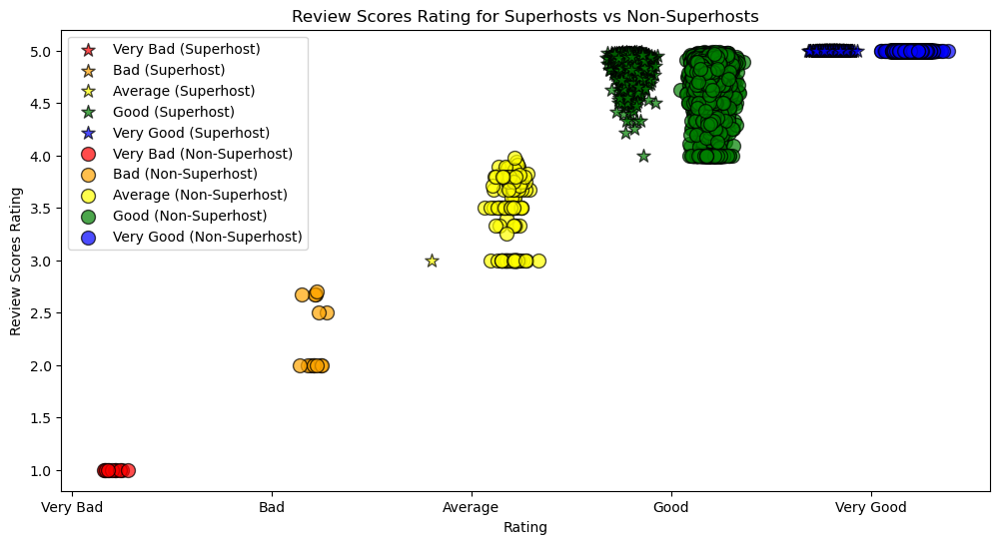

In [43]:
# Ratings jitter plot: superhost vs non-superhost

file = 'listings.csv'
data = pd.read_csv(file)

# Extract superhost and non-superhost data
sh = data[data['host_is_superhost'] == 't']
nsh = data[data['host_is_superhost'] == 'f']

# Extract review scores ratings
rating_sh = sh['review_scores_rating'].dropna()
rating_nsh = nsh['review_scores_rating'].dropna()

# Establish ranges for both superhost and non-superhost ratings
ranges = [(1, "Very Bad"), (2, "Bad"), (3, "Average"), (4, "Good"), (5, "Very Good")]
colors = ['red', 'orange', 'yellow', 'green', 'blue']

# Create a dictionary to store the data for superhost and non-superhost
data_dict = {
    'sh': {category: rating_sh[(rating_sh >= i) & (rating_sh < i + 1)] for i, category in ranges},
    'nsh': {category: rating_nsh[(rating_nsh >= i) & (rating_nsh < i + 1)] for i, category in ranges}
}

# Plot jitter plot for superhost and non-superhost ratings together
plt.figure(figsize=(12, 6))

# Plot superhost ratings
for i, (x_offset, category) in enumerate(ranges):
    x_sh = np.random.normal(x_offset - 0.2, 0.04, len(data_dict['sh'][category]))
    plt.scatter(x_sh, data_dict['sh'][category], color=colors[i], marker='*', label=f'{category} (Superhost)', s=100, alpha=0.7, edgecolors='black')

# Plot non-superhost ratings
for i, (x_offset, category) in enumerate(ranges):
    x_nsh = np.random.normal(x_offset + 0.2, 0.04, len(data_dict['nsh'][category]))
    plt.scatter(x_nsh, data_dict['nsh'][category], color=colors[i], label=f'{category} (Non-Superhost)', s=100, alpha=0.7, edgecolors='black')

# Add labels and legend
plt.xlabel('Rating')
plt.ylabel('Review Scores Rating')
plt.title('Review Scores Rating for Superhosts vs Non-Superhosts')
plt.xticks(np.arange(1, 6), [category for _, category in ranges])
plt.legend()

# Show plot
plt.show()


In this jitter plots, we could appreciate and analyse the different in scoring that differentiates *Superhosts* from regular hosts.

In [2]:
import mpld3

file = 'listings.csv'
data = pd.read_csv(file)
# Sort the DataFrame by the 'host_since' column
data_sorted = data.sort_values(by='host_since')

C:\Users\victo\AppData\Local\Temp\ipykernel_10480\3404984121.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(x="host_is_superhost", y="host_since", data=data_sorted, split=True, palette=colors, alpha=0.7)


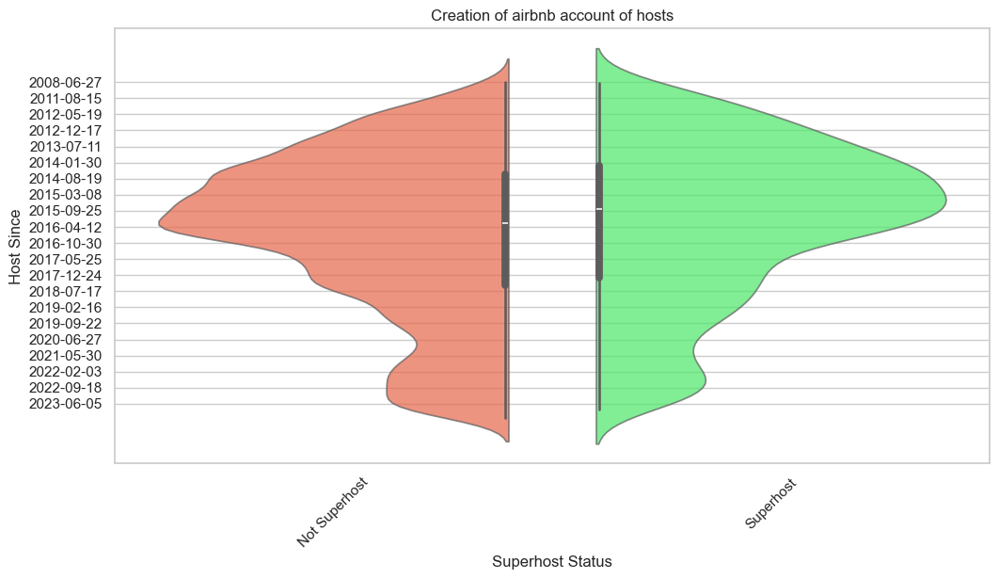

In [3]:
sns.set(style="whitegrid")

colors = ["#FF5733", "#33FF57"] 

# Create a seaborn violin plot
plt.figure(figsize=(12, 6))
ax = sns.violinplot(x="host_is_superhost", y="host_since", data=data_sorted, split=True, palette=colors, alpha=0.7)
plt.title('Creation of airbnb account of hosts')
plt.xlabel('Superhost Status')
plt.ylabel('Host Since')
plt.xticks(ticks=[0, 1], labels=['Not Superhost', 'Superhost'])

# Rotate y-axis labels for better readability
plt.xticks(rotation=45)

# Set fewer y-axis ticks
plt.yticks(ticks=plt.yticks()[0][::200])

# Show the plot
plt.savefig('host_since.png')
#plt.show()

# Convert the plot to an interactive HTML plot
html_plot = mpld3.fig_to_html(plt.gcf())

# Save the HTML plot to a file
with open('host_since.html', 'w') as f:
    f.write(html_plot)

With the violin plot above, it can be seen what time did a host become a host for the first time. The plot has the most recent dates at the bottom and the most ancient ones on the top. At first sight, it is clear how around 2015, lots of new hosts came to the airbnb platform. The graph peaks again in 2022. Even though both sides of the figure look very simiilar, with deep inspection it can be seen how the green tendency is always ahead of the red one, meaning that superhosts became host before to their relative comparison. Is is important to mention that both sides are equally large, but that does not mean the number of super hosts is equal to the number of regular hosts. The amount of super hosts is smaller.

Relevant insights that can be obtained from the plot are that the inscription of new hosts follow a specific curve (the reason behind that curve is unknown with the information avaiolable, except for 2020 and 2021 sicne the reasons are clearly the pandemic), and that super hosts seem to be the precursors when new hosts sign up to airbnb.

In [6]:
from bokeh.plotting import figure, output_notebook, show, output_file, save
from bokeh.models import ColumnDataSource, CheckboxGroup, CustomJS

# Output the plot directly in the Jupyter Notebook
output_notebook()
output_file("airbnb_listings_histogram.html")

# Assuming 'data' is your DataFrame containing Airbnb information

# Handle missing values
data['host_listings_count'].fillna(data['host_listings_count'].median(), inplace=True)

# Filter the data for regular hosts and superhosts
regular_hosts_data = data[data['host_is_superhost'] == 'f']
superhosts_data = data[data['host_is_superhost'] == 't']

# Set up the figure
p = figure(title='Distribution of Number of Listings by Host Type', x_axis_label='Number of Listings', y_axis_label='Count', x_range=(1, 20), y_range=(0, 300))

# Calculate histogram bins
regular_hist, regular_edges = np.histogram(regular_hosts_data['host_listings_count'], bins=np.arange(1, max(data['host_listings_count']) + 2, 1))
superhost_hist, superhost_edges = np.histogram(superhosts_data['host_listings_count'], bins=np.arange(1, max(data['host_listings_count']) + 2, 1))

# Create the ColumnDataSource for regular hosts
source_regular = ColumnDataSource(data=dict(
    top=regular_hist,
    bottom=np.zeros_like(regular_hist),
    left=regular_edges[:-1],
    right=regular_edges[1:]
))

# Create the ColumnDataSource for superhosts
source_superhost = ColumnDataSource(data=dict(
    top=superhost_hist,
    bottom=np.zeros_like(superhost_hist),
    left=superhost_edges[:-1],
    right=superhost_edges[1:]
))

# Create the histogram for regular hosts
regular_renderer = p.quad(top='top', bottom='bottom', left='left', right='right', source=source_regular, color='blue', legend_label='Regular Host', alpha=0.7)

# Create the histogram for superhosts
superhost_renderer = p.quad(top='top', bottom='bottom', left='left', right='right', source=source_superhost, color='red', legend_label='Superhost', alpha=0.7)

# Add legend
p.legend.title = 'Host Type'

# Show the plot with checkbox
show(p)
save(p)


Loading BokehJS ...

C:\Users\victo\AppData\Local\Temp\ipykernel_10480\2807472135.py:11: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data['host_listings_count'].fillna(data['host_listings_count'].median(), inplace=True)


'C:\\Users\\victo\\OneDrive\\Escritorio\\UNI\\DTU\\q2\\Social Data\\project\\airbnb_listings_histogram.html'

With this plot it is evidenced that the vaste majority of hosts only have one listing, and that having 2 or 3 listings is quite popular. From there on the count drops to lower values, since the economic resources required to have many listings are much bigger. The histogram above reveals an insight that may seem contradictory. It can be seen that hosts with 7 or more listings are mostly regular hosts, while it would make sense that these people where super hosts. 

<Figure size 1000x600 with 0 Axes>

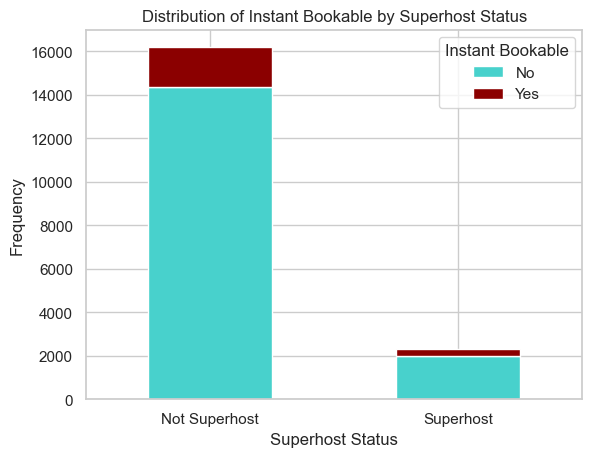

In [7]:
# Group data by 'host_is_superhost' and 'instant_bookable' and count occurrences
grouped_data = data.groupby(['host_is_superhost', 'instant_bookable']).size().unstack()
sns.set(style="whitegrid")
# Plot the data
plt.figure(figsize=(10, 6))
grouped_data.plot(kind='bar', stacked=True, color=['mediumturquoise', 'darkred'])

# Add labels and title
plt.title('Distribution of Instant Bookable by Superhost Status')
plt.xlabel('Superhost Status')
plt.ylabel('Frequency')
plt.xticks(ticks=[0, 1], labels=['Not Superhost', 'Superhost'], rotation=0)
plt.legend(title='Instant Bookable')

# Customize the legend labels
plt.legend(['No', 'Yes'], title='Instant Bookable')
plt.savefig('instant_bookable_.pdf')
# Convert the plot to an interactive HTML plot
html_plot = mpld3.fig_to_html(plt.gcf())

# Save the HTML plot to a file
with open('instant_bookable_.html', 'w') as f:
    f.write(html_plot)

Here it can be seen how there is no apparent difference between hosts and super hosts for what the instat booking does. There are more rgular hosts that accept instant bookings, but that is because there are more regular hosts. If the percentage is taken into account, it is very similar. Also, it would make sense that super hosts allowed less instant bookings, since they are more wanted by tenants and therfore more booked thoroughout the year.

-----------------------------------------------------------------------------------------------------------------------

## **Genre**

**Which genre of data story did you use?**

The webstite created follows the magazine style

**Which tools did you use from each of the 3 categories of Visual Narrative (Figure 7 in Segal and Heer). Why?**

From visual structuring, we used:
- Consistent visual platform

From highlighting, we used:
- Close-ups
- Feature distinction
- Zooming


From transition guidance, we used:

- iocnweoinc

**Which tools did you use from each of the 3 categories of Narrative Structure (Figure 7 in Segal and Heer). Why?**

From ordering we used:


From interactivity, we used:

From messaging, we used:


## **Visualizations**
**Explain the visualizations you've chosen. 
Why are they right for the story you want to tell**

Along this project several types of visualizations have been used. Below a list can be found.
- Maps
- Bar plot
- Pie chart
- Scatter plot
- Violin plot

It is important to mention that some of th eplots in this project are Bokeh plots, studied along the course, which are interactive plots that let the viewer participate in the analysis. They also have practical utilities, such as zooming in and out to better visualize the data. The plots chosen along the project have suited us well, because they have allowed us to present the data in a structured way.

With the different maps used, we achieved a better understanding of the data and the object of study, the super hosts. Regarding the several bar plots used, the tema has been able to compare numerical and categorical values of the data, such as neighbourhoods, sums of certain features or percentages. The bar plots used have  been stacked and unstacked, as well as grouped and ungrouped, depending on the needs. Pie charts have also been very usefull, when studying features with multioploe options, such as the respons time of the hosts or the type of verification, since they provide a holystic view of the distribution in percentages. The scatter plots are not so frequent in this analysis, however they have shown some very valuable information. Finally, the violin plot has provided a very direct comparison between dates of inscription to the system, making it a very suitable option for that type of feature.

As a conclusion, it can be stated that the plots used have been very helpful in order to tell the story. They have provided the right insights to deeply understand the differences between hosts and super hosts?

## **Discussion**
**Think critically about your creation. What went well?, What is still missing? What could be improved?, Why?**

After having conducted the analysis, lots of insights have been accuired from the Copenhagen Airbnb dataset. The team has learned about the differences between hosts and super hosts and what that differences imply. Some big differences have been seen, between regular hosts and super hosts, in certain features, while other features barely had any difference. Apart from that, it is important to be self critic with the work done, so that future work can be improved. Along the project, certain correlations have been found between features and the categorical variable "superhost", for which we have provided our own interpretation of the results, however, we were missing more data to support our interpretations. In order to improve the project, it would be great to find the reason behing correlations, whether they are social, political or economical reasons, with data (or proof) supporting it. A way to find this explanations would be to merge this dataset with another one, depending on the object of study. With this extra information, along with the reading of several papers, more details and context could be provided, to better understand how Airbnbs work in the area of Copenhagen.

## **Contributions**
**Who did what? You should write (just briefly) which group member was the main responsible for which elements of the assignment. (I want you guys to understand every part of the assignment, but usually there is someone who took lead role on certain portions of the work. That's what you should explain). It is not OK simply to write "All group members contributed equally". 
Make sure that you use references when they're needed and follow academic standards.**



The team has split the work, in order to work in an organised way and avoid have overlapinds. The skeleton of the analysis was conducted by Andrea and Víctor, while Estel was working on the website. However, the three members reviewd everything together.

Estel Clua i Sánchez (s232507) --> Creating the git web

Andrea Matamoros Alonso (s233514) --> Bar plot (neighbourhoods), maps without heatmap layer, pie charts, scatter plots, bar plots (availability)

Víctor Sobrino Cusidó (s232773) --> Maps with the heatmap layer, violin plot (host since), bokeh plot (listings count), stacked bar plot (instant bookable)